In [1]:
from mhe import *
from mpc import *
from IPython.display import display, Markdown, Latex
import json

### Simulation parameters
Defines the total simulation time and sampling time for system identification.

In [2]:
# Total simulation time: 600s
total_time = 600

# Sampling time: 0.1s
t_step = 0.1

# Number of estimation step: total_time/t_step = 6000
steps = int(total_time/t_step)

### Estimation loop
It defines the parameters of the estimator, instantiates the object of the estimator class and starts the estimation loop.


******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit https://github.com/coin-or/Ipopt
******************************************************************************

This is Ipopt version 3.14.4, running with linear solver MUMPS 5.4.1.

Number of nonzeros in equality constraint Jacobian...:     1460
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:      468

Total number of variables............................:      426
                     variables with only lower bounds:       14
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:      380
Total number of inequality co

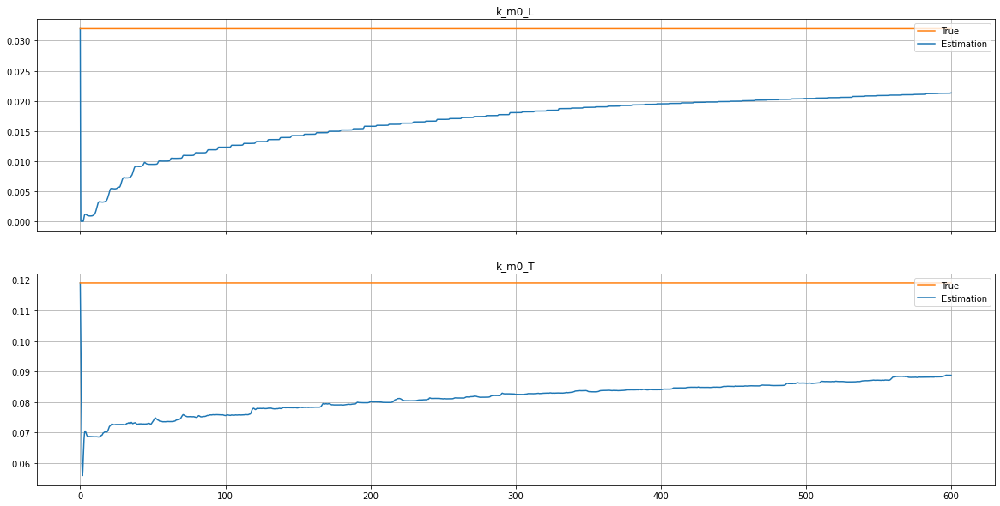

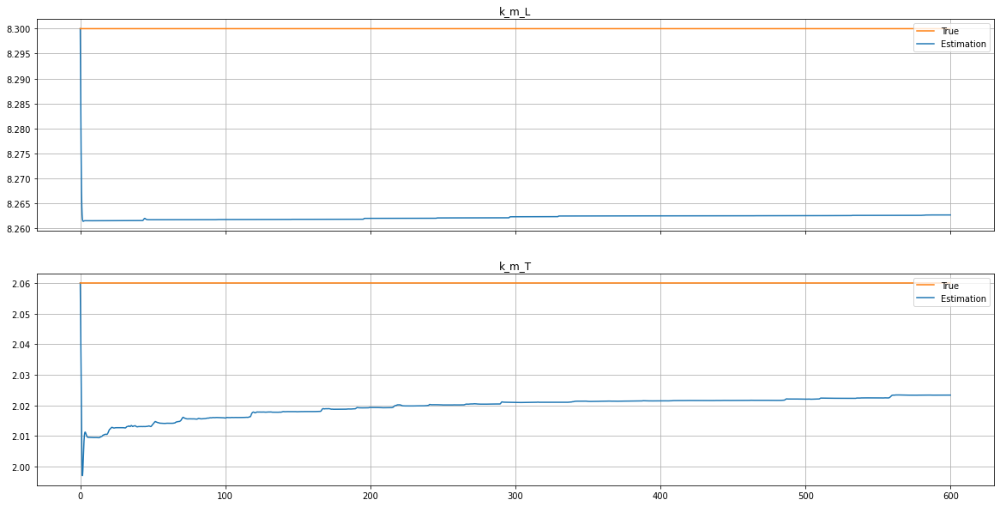

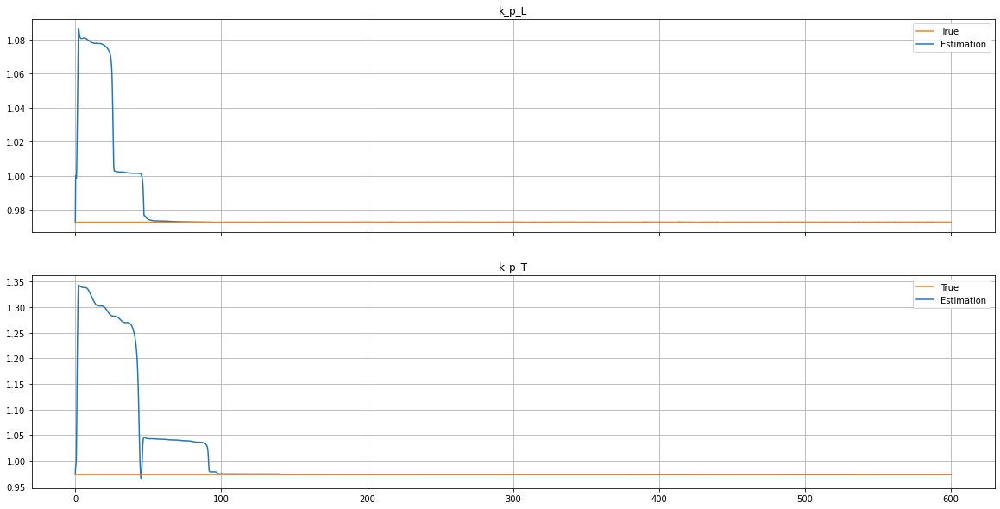

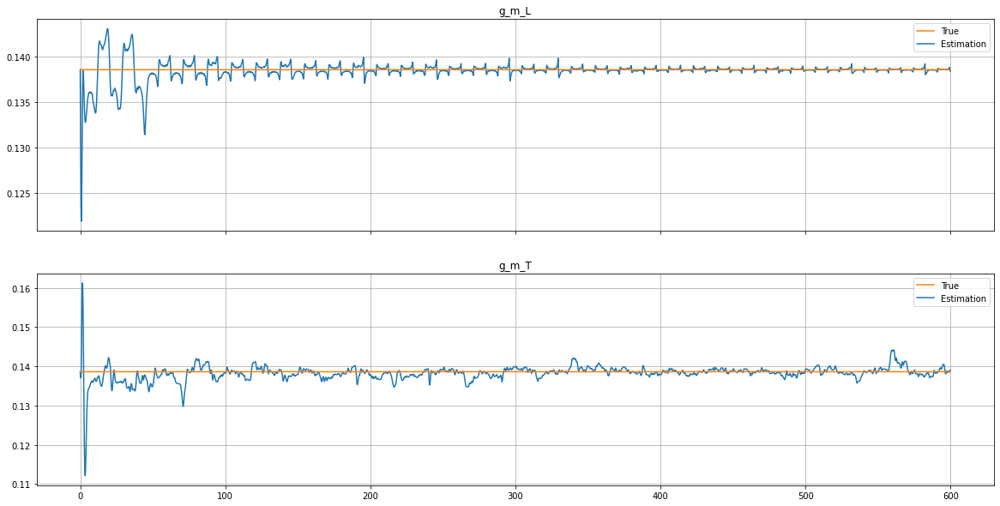

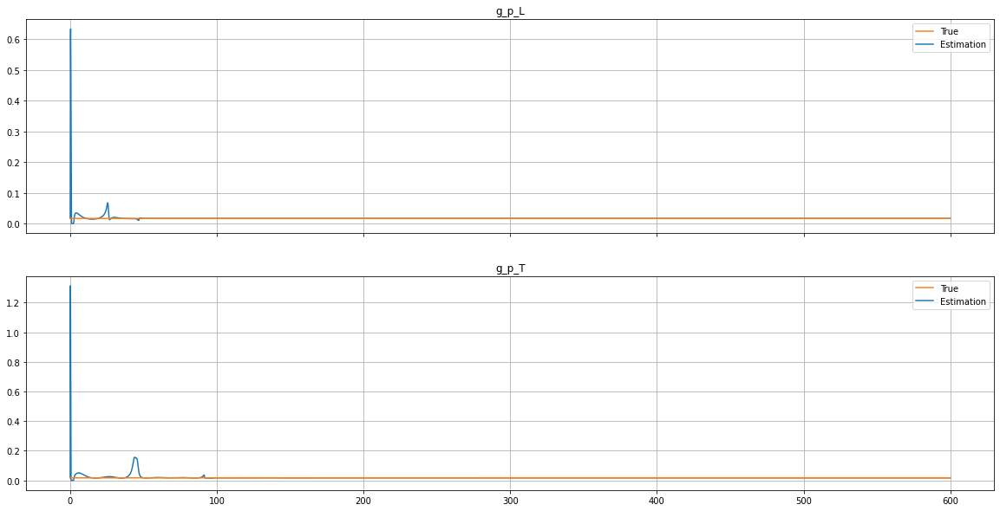

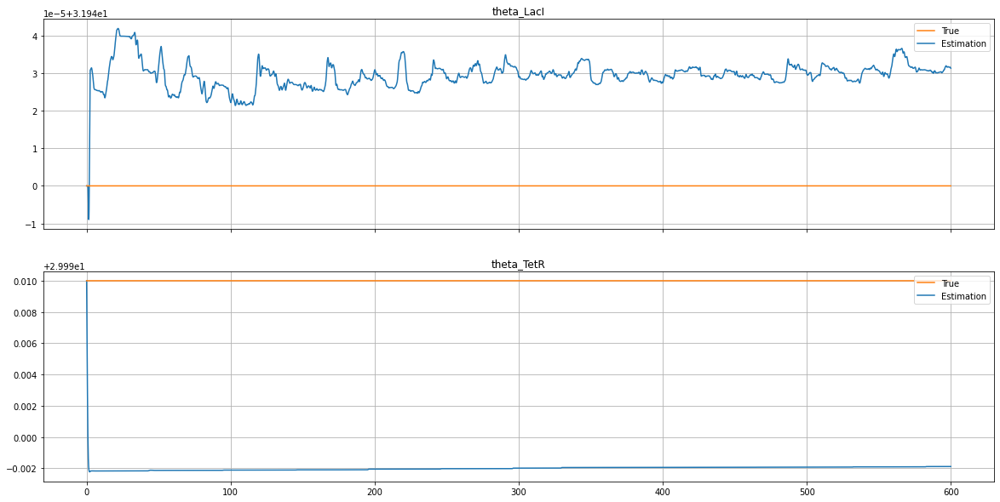

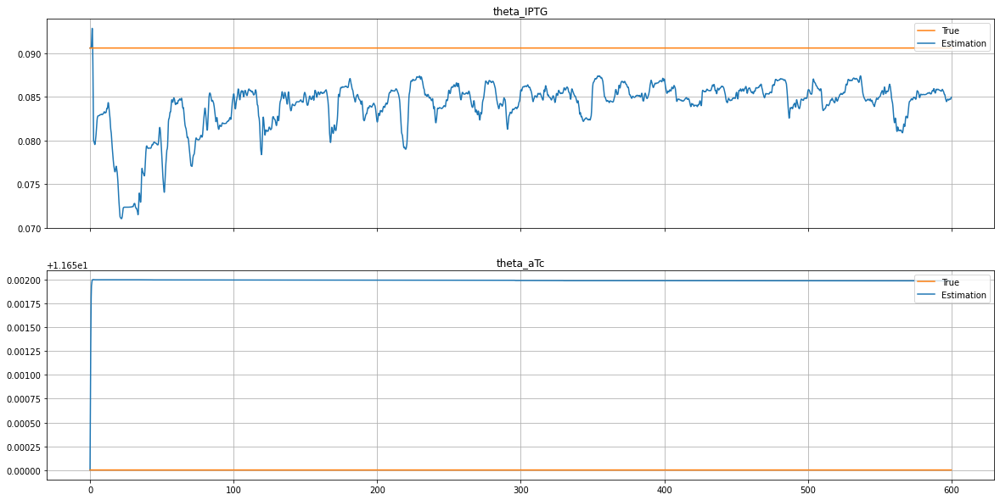

In [3]:
setup_mhe = {
    't_step': t_step,
    'n_horizon': 10,
    'store_full_solution': True,
    'meas_from_data': True
}

x_0 = np.array([3.50e-2, 1.20e-1, 10, 30, 3.50e-2, 1.20e-1, 10, 30]).reshape(-1,1)
p_est0 = np.array([3.20e-2, 1.19e-1, 8.30, 2.06, 9.726e-1, 9.726e-1, 1.386e-1, 1.386e-1, 1.65e-2, 1.65e-2, 31.94, 30.00, 9.06e-2, 11.65])

mhe_estimator = EstimatorMHE(t_step, setup_mhe)
estimator_data = mhe_estimator.estimation_loop(x_0, p_est0, steps)


### Simulation parameters
Defines the total simulation time and sampling time.

In [4]:
# Total simulation time: 24h (1440m)
total_time = 1440  

# Sampling time: 1m
t_step = 1

# Number of control step: total_time/t_step = 1440
steps = int(total_time/t_step) 

# Get average trajectory every 240 m
avg_period = 240  

# Initial conditions
x_0 = np.array([30, 50, 400, 125, 0, 0])

# References
LacI_ref = 750
TetR_ref = 300


### Control loop
It defines the parameters of the controller, instantiates the object of the model class to be controlled and the object of the controller class and starts the control loop.

In [5]:
setup_mpc = {
    'n_robust': 1,
    'n_horizon': 7,
    't_step': t_step,
    'store_full_solution': True
}

toggle = ToggleSwitchIdentifiedModel(False, LacI_ref, TetR_ref, t_step, total_time, avg_period, estimator_data)
mpc_controller = ControllerMPC(toggle, t_step, setup_mpc, False)


In [ ]:
%%capture
mpc_controller.control_loop(x_0, steps, 'identified', 1)

### Performance metrics and results plot
It calculates ISE and ITAE values and plots closed-loop simulations.

#### Performance metrics


<center>

| **Metric** | **Value** |
|------------|-----------|
| ISE        | 11.99     |
| ITAE       | 5.88e+04    |


#### Results plot

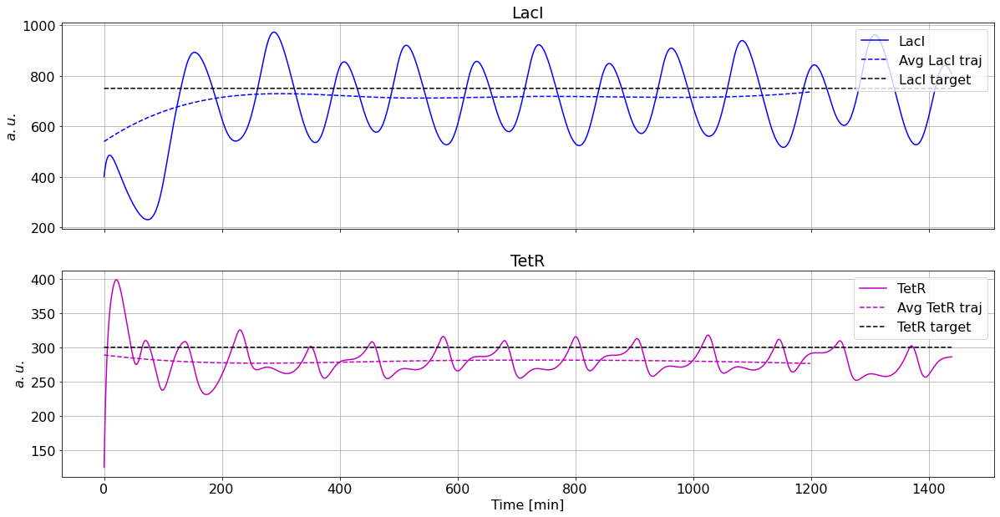

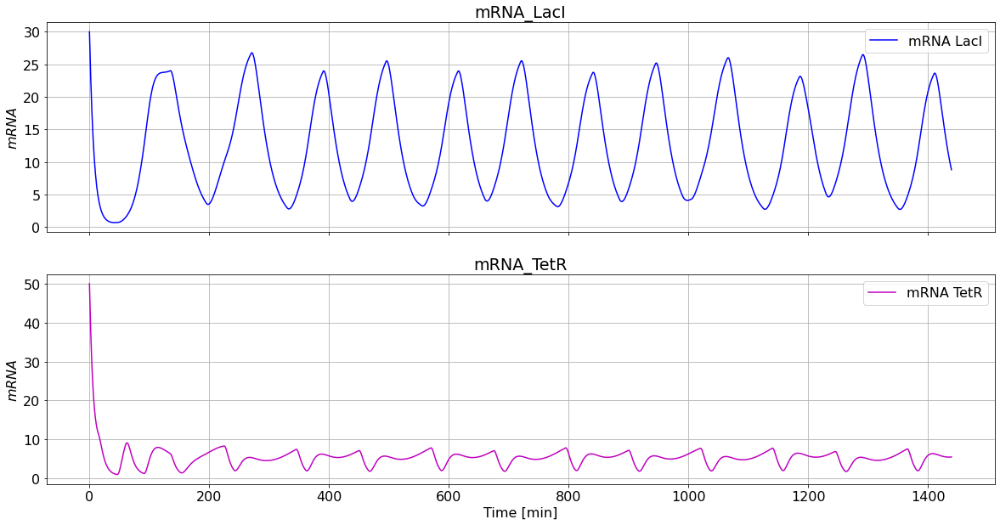

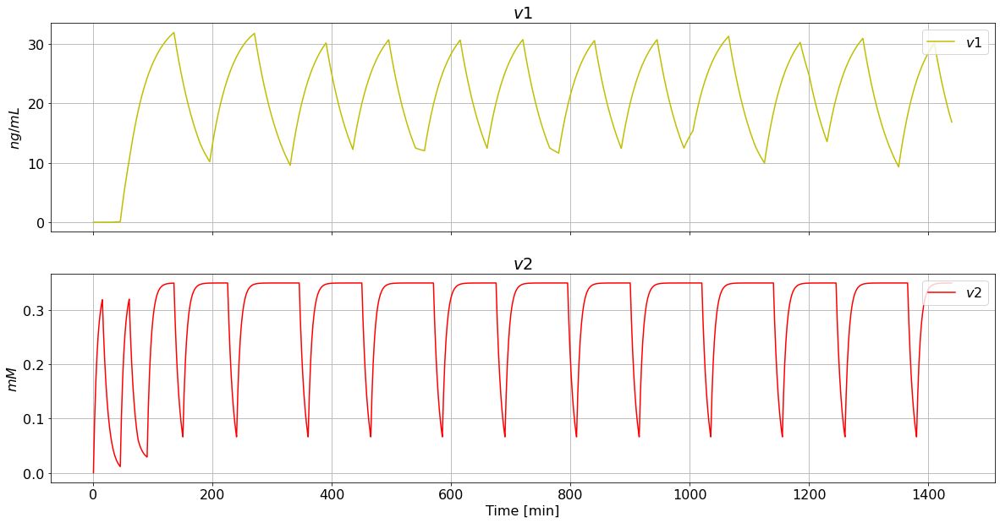

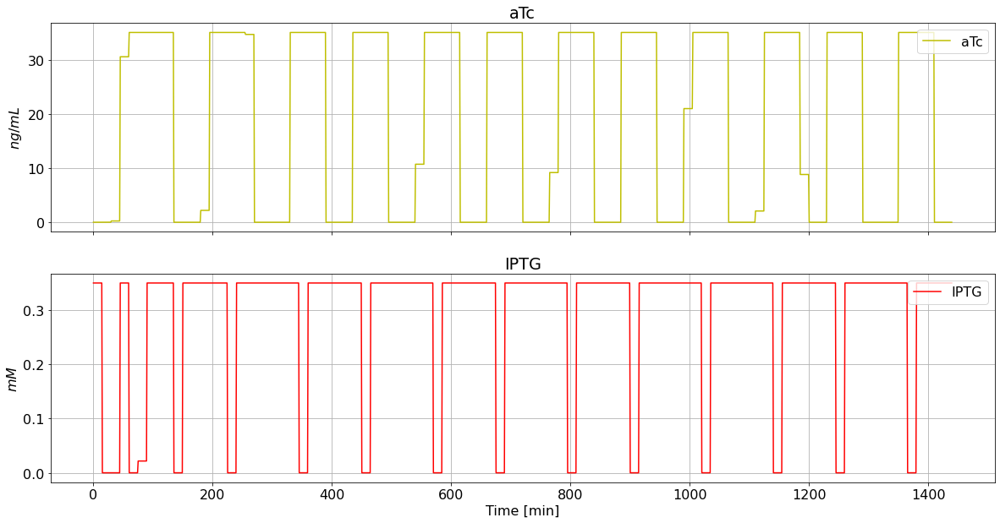

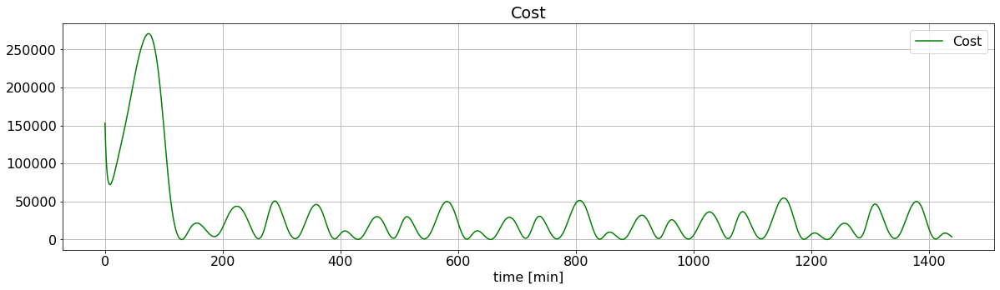

In [6]:
display(Markdown('#### Performance metrics'))
metrics = """
<center>

| **Metric** | **Value** |
|------------|-----------|
| ISE        | {ISE}     |
| ITAE       | {ITAE}    |
""".format(ISE = "{:.2f}".format(toggle.trajectories['ISE']), ITAE = format(toggle.trajectories['ITAE'], '.2e'))

display(Markdown(metrics))

display(Markdown('#### Results plot'))
figures, lines = toggle.plot_results()


### Plots animation
It animates closed-loop simulations and exports them in mp4 format.

In [7]:
toggle.animate_results('identified', 'proteins', toggle.update_protein, figures[0], (toggle.trajectories, lines[0:6], np.arange(0, total_time - ((total_time-1) % avg_period) - 1, t_step)), steps)
toggle.animate_results('identified', 'mRNAs', toggle.update_mRNA, figures[1], (toggle.trajectories, lines[6:8]), steps)
toggle.animate_results('identified', 'internal_inducers', toggle.update_internal_inducers, figures[2], (toggle.trajectories, lines[8:10]), steps)
toggle.animate_results('identified', 'external_inducers', toggle.update_external_inducers, figures[3], (toggle.trajectories, lines[10:12]), steps)
toggle.animate_results('identified', 'cost', toggle.update_cost, figures[4], (toggle.trajectories, lines[12:13]), steps)